LOG:
PROGRESS : MOUSE : SECTION : STRUCTURE
CURRENT-  : MD594 : 300 : VLL_R
CURRENT-  : MD594 : 308 : VLL_R
CURRENT-  : MD594 : 150 : VLL_L
CURRENT-  : MD594 : 332 : VCP_R
CURRENT-  : MD594 : 336 : VCP_R
CURRENT-  : MD589 : 220 : RtTg_S 
CURRENT-  : MD589 : 222 : RtTg_S 
CURRENT-  : MD589 : 223 : RtTg_S 
CURRENT-  : MD589 : 240 : RtTg_S 
CURRENT-  : MD589 : 337 : Sp5I_R 
CURRENT-  : MD589 : 155 : VLL_L 


'done'

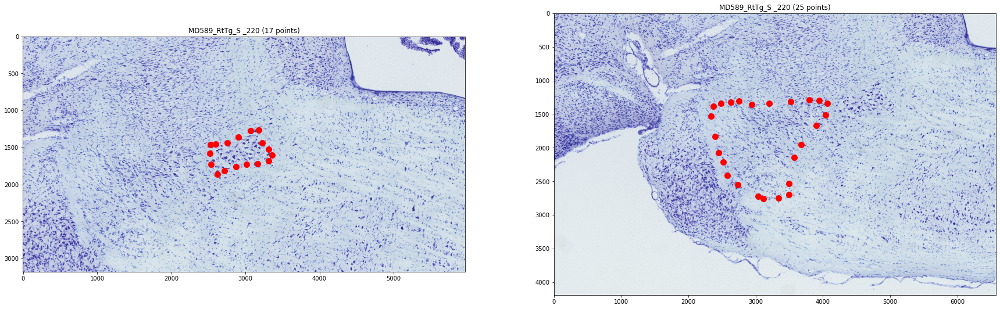

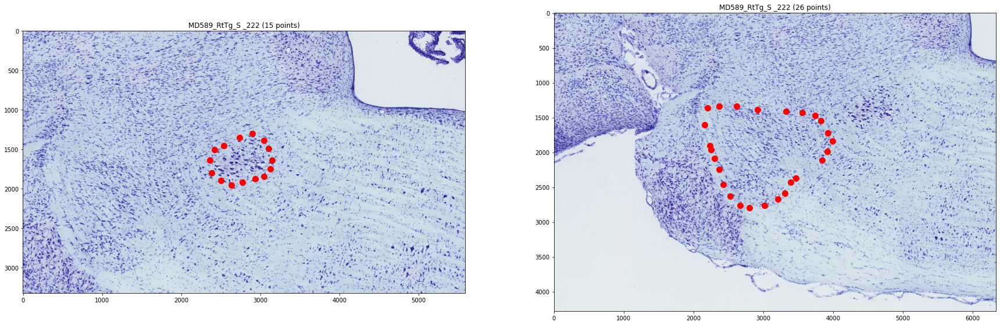

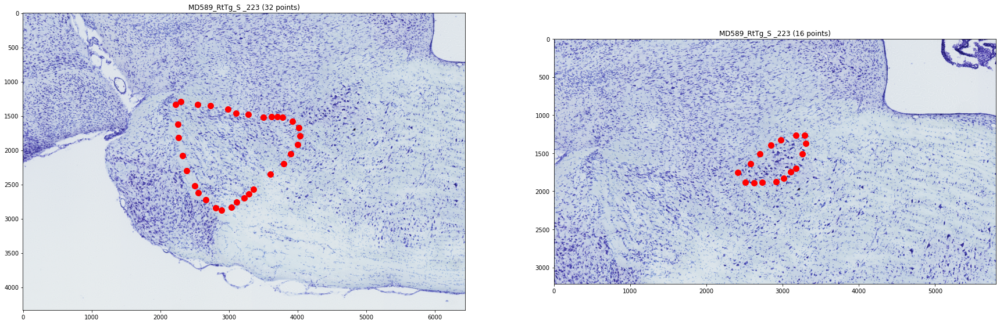

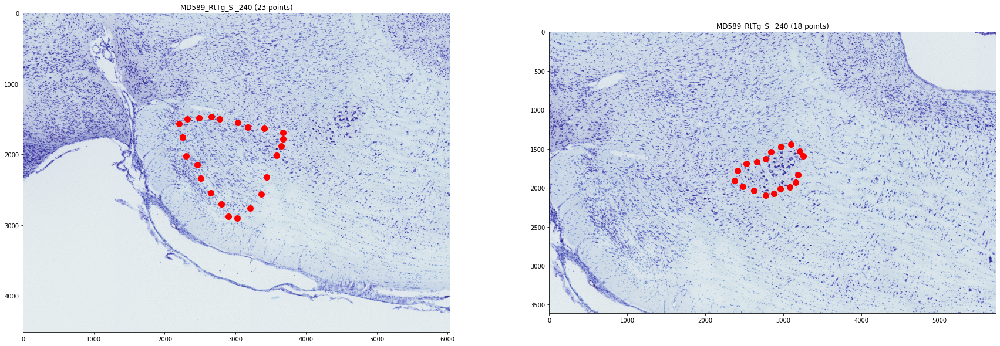

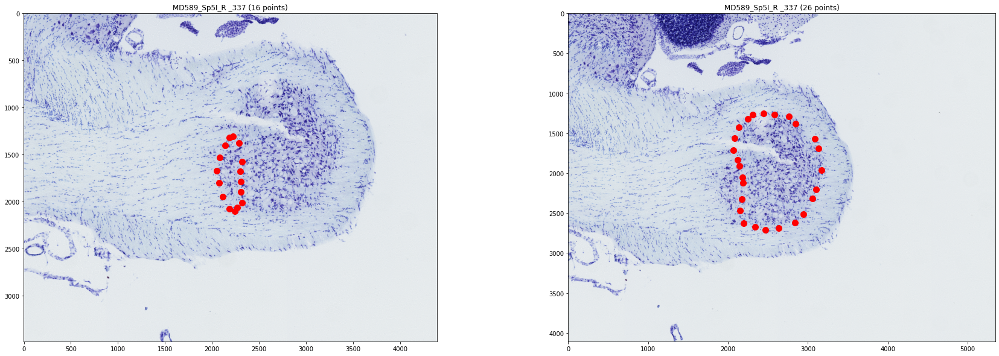

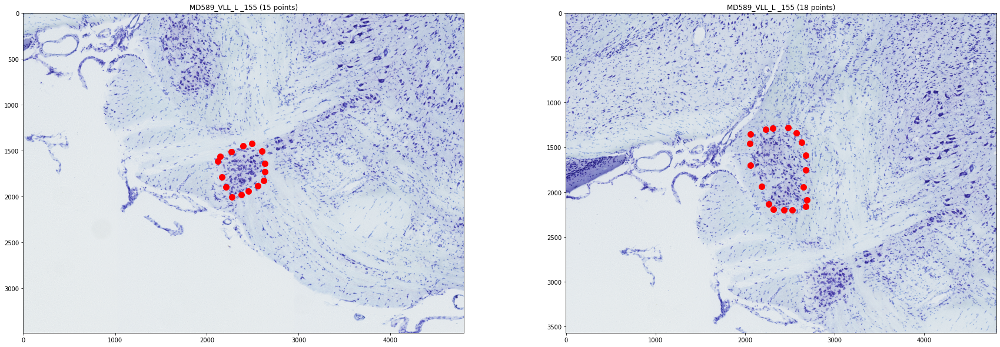

In [12]:
'''
COMPARE FOUNDATION BRAIN IMAGES' VERTICIES 

CREATED: 10-MAR-2022
LAST EDIT: 11-MAR-2022
AUTHORS: ZHONGKAI AND DUANE
READ DUPLICATE VERTICIES POINTS, [SCATTER] PLOT ON TOP OF IMAGE
PUT SIZE-BY-SIDE FOR EVALUATION (WHICH IS CORRECT?)
'''

# e.g. full resolution images location 
# /net/birdstore/Active_Atlas_Data/data_root/pipeline_data/MD594/preps/CH1/full

import os
import re
from tifffile import imread #SUPPORTS TIFF FILES >2GB IN SIZE
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from pandas import ExcelWriter
from pandas import ExcelFile

out_path = "/net/birdstore/drinehart/img_compare/"
src_contours = os.path.join(out_path, "compare.xlsx")

def load_contours():
    '''LOAD IN DUPLICATED (POTENTIALY) SETS OF CONTOURS (POINTS)'''
    in_contours = pd.read_excel(
        os.path.join(src_contours),
        engine='openpyxl',
    )
    return in_contours[['MOUSE','SECTION','STRUCTURE', 1, 2]] 


def create_plot(mouse, section, structure, lstpairs1, lstpairs2):
    #DEFINE PARTIAL IMAGE 'VIEW' (MARGINS) FOR IMG1
    cmin1=np.min(lstpairs1, axis=0)
    cmax1=np.max(lstpairs1, axis=0)
    margin1=np.array((cmin1*.9,cmax1*1.1)).astype(int)
    contour1 = np.array(lstpairs1)-cmin1*.9
    
    #DEFINE PARTIAL IMAGE 'VIEW' (MARGINS) FOR IMG2
    cmin2=np.min(lstpairs2, axis=0)
    cmax2=np.max(lstpairs2, axis=0)
    margin2=np.array((cmin2*.9,cmax2*1.1)).astype(int)
    contour2 = np.array(lstpairs2)-cmin2*.9

    #LOAD BACKGROUND IMAGE ON PLOT
    img = imread(f"/net/birdstore/Active_Atlas_Data/data_root/pipeline_data/{mouse}/preps/CH1/full/{section}.tif")
    gimg=np.array(img)

    plt.figure(figsize=[30,10])
    plt.subplot(1,2,1)
    
    cnt_verticies1 = np.count_nonzero(contour1, axis=0)[0]
    plt.title(f"{mouse}_{structure}_{section} ({cnt_verticies1} points)")
    plt.imshow(gimg[margin1[0,1]:margin1[1,1], margin1[0,0]:margin1[1,0]], cmap='gray')
    plt.scatter(contour1[:,0],contour1[:,1], color='r', s=100)

    plt.subplot(1,2,2)
    cnt_verticies2 = np.count_nonzero(contour2, axis=0)[0]
    plt.title(f"{mouse}_{structure}_{section} ({cnt_verticies2} points)")
    plt.imshow(gimg[margin2[0,1]:margin2[1,1], margin2[0,0]:margin2[1,0]], cmap='gray')
    plt.scatter(contour2[:,0],contour2[:,1], color='r', s=100)

    out_filename = f"{mouse}_{structure}_{section}.jpg"
    plt.savefig(out_path+out_filename)


def parse_contours(contours1):
    #print(index, row['MOUSE'], row['SECTION'], row['STRUCTURE'], row[1], row[2]) - DEBUG: SRC LAYOUT
    print("PROGRESS", 'MOUSE', 'SECTION', 'STRUCTURE', sep=" : ")
    for index, row in contours1.iterrows():

        print("CURRENT- ", row['MOUSE'], row['SECTION'], row['STRUCTURE'], sep=" : ")

        #***PARSE X,Y VALUES (VERTICES)***
        #REMOVE BRACKETS FROM STRING
        lstcontour_points1 = re.sub(r"[\([{})\]]", '', row[1]).split("\n")
        lstcontour_points2 = re.sub(r"[\([{})\]]", '', row[2]).split("\n")

        lstpairs1 = []
        lstpairs2 = []
        #LIST OF TUPLES - EACH TUPLE HAS X,Y POINTS
        for pairs in lstcontour_points1:
            lstpair = list(filter(str.strip,pairs.split(" "))) #REMOVE STRINGS ELEMENTS THAT ONLY CONTAIN WHITESPACE (NULL) FROM LIST
            pair = (float(lstpair[0]), float(lstpair[1]))
            lstpairs1.append(pair)
        
        for pairs in lstcontour_points2:
            lstpair = list(filter(str.strip,pairs.split(" "))) #REMOVE STRINGS ELEMENTS THAT ONLY CONTAIN WHITESPACE (NULL) FROM LIST
            pair = (float(lstpair[0]), float(lstpair[1]))
            lstpairs2.append(pair)

        create_plot(row['MOUSE'], row['SECTION'], row['STRUCTURE'], lstpairs1, lstpairs2)

        #DEBUG:
        #if row['MOUSE'] == 'MD589':
        #    create_plot(row['MOUSE'], row['SECTION'], row['STRUCTURE'], lstpairs1, lstpairs2)
        
    return 'done'


contours = load_contours()
print("LOG:")
parse_contours(contours)

LOG:
PROGRESS : MOUSE : SECTION : STRUCTURE
CURRENT-  : MD594 : 299 : VLL_R
CURRENT-  : MD594 : 301 : VLL_R
CURRENT-  : MD594 : 307 : VLL_R
CURRENT-  : MD594 : 309 : VLL_R
CURRENT-  : MD594 : 149 : VLL_L
CURRENT-  : MD594 : 151 : VLL_L
CURRENT-  : MD594 : 331 : VCP_R
CURRENT-  : MD594 : 333 : VCP_R
CURRENT-  : MD594 : 335 : VCP_R
CURRENT-  : MD594 : 337 : VCP_R
CURRENT-  : MD589 : 215 : RtTg_S 
CURRENT-  : MD589 : 225 : RtTg_S 
CURRENT-  : MD589 : 230 : RtTg_S 
CURRENT-  : MD589 : 245 : RtTg_S 
CURRENT-  : MD589 : 336 : Sp5I_R 
CURRENT-  : MD589 : 154 : VLL_L 
CURRENT-  : MD589 : 156 : VLL_L 


'done'

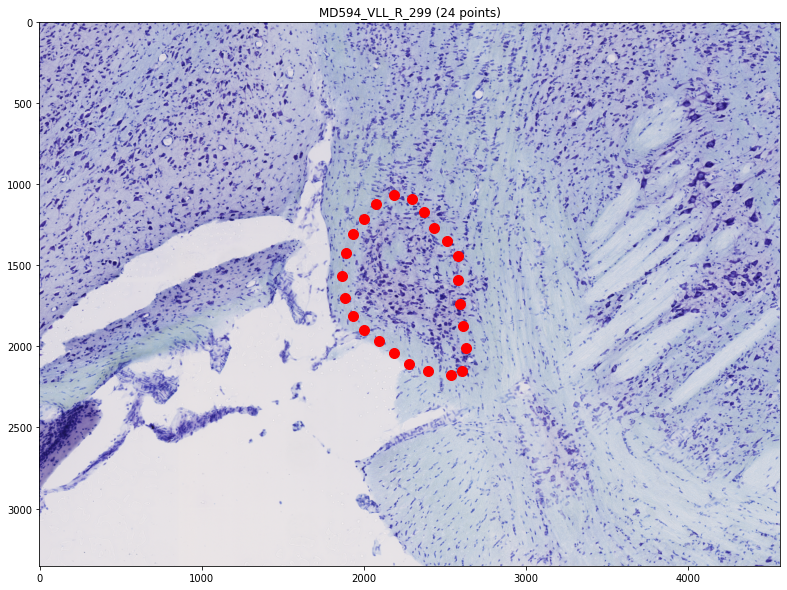

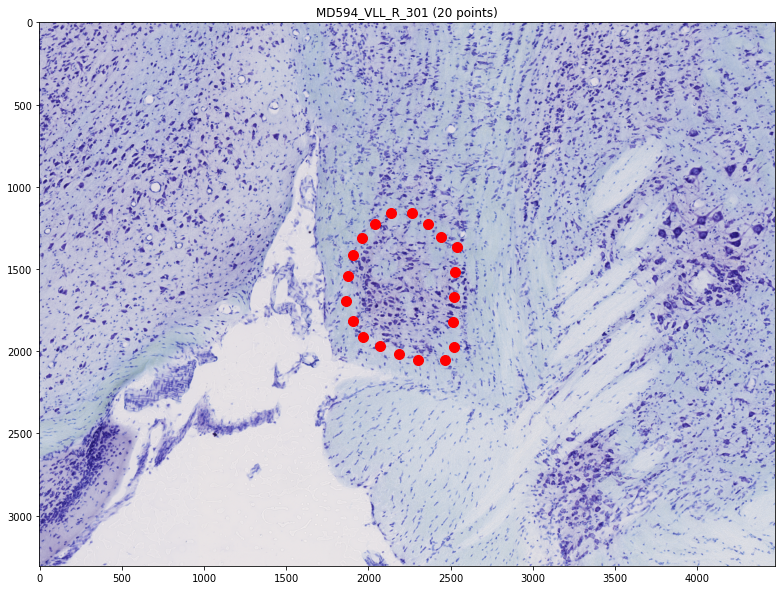

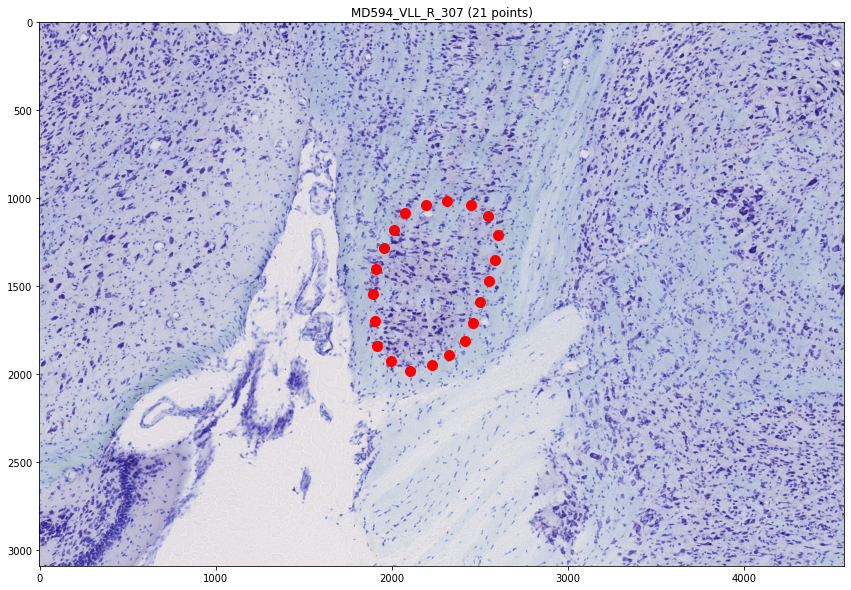

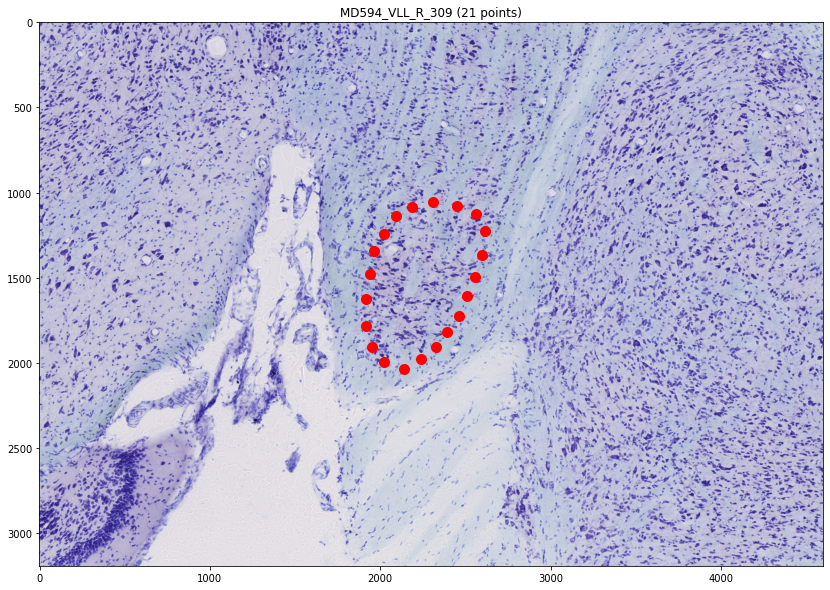

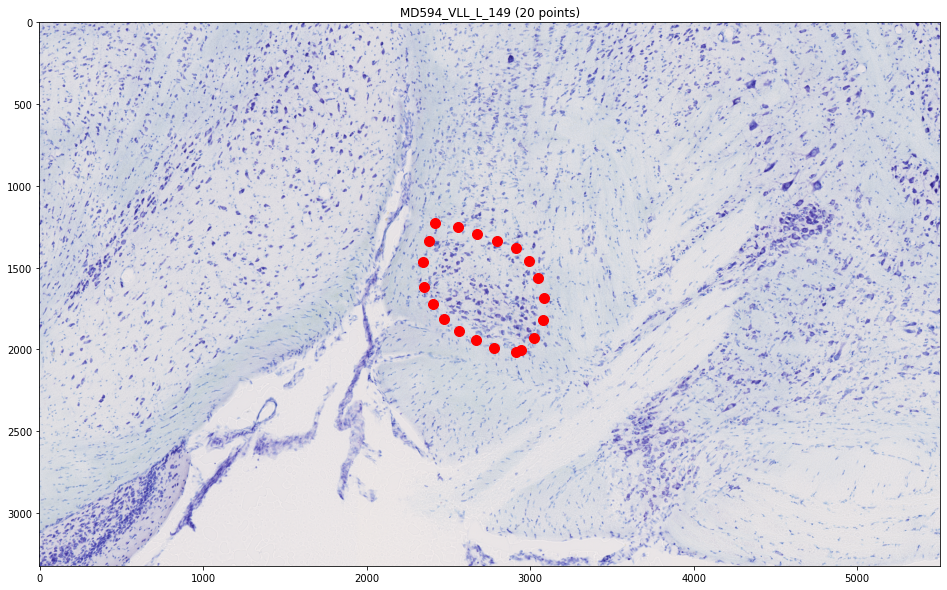

...

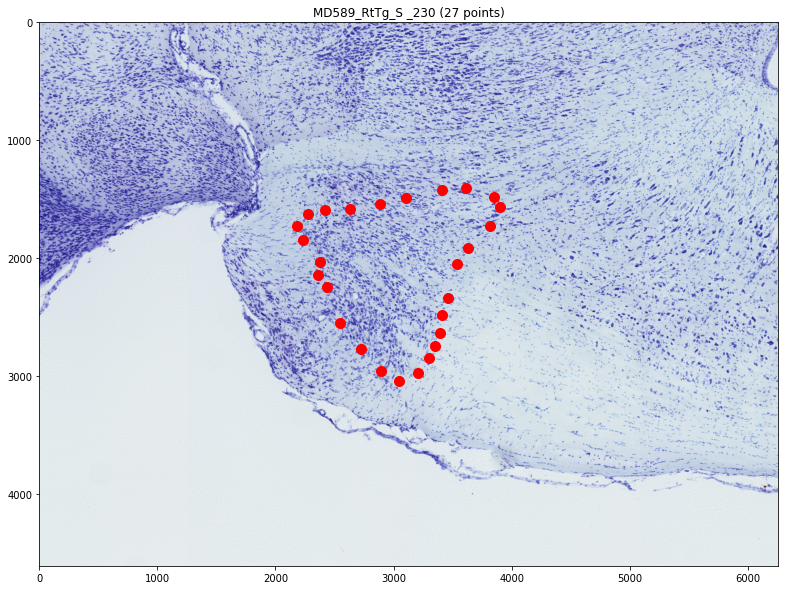

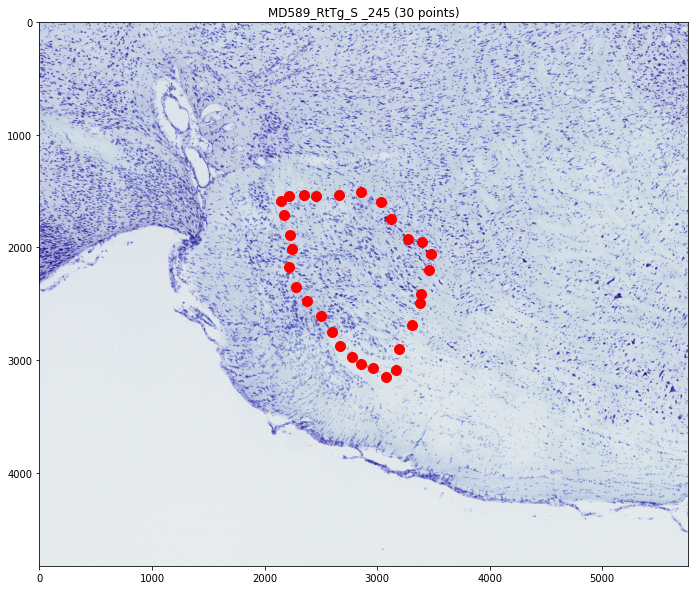

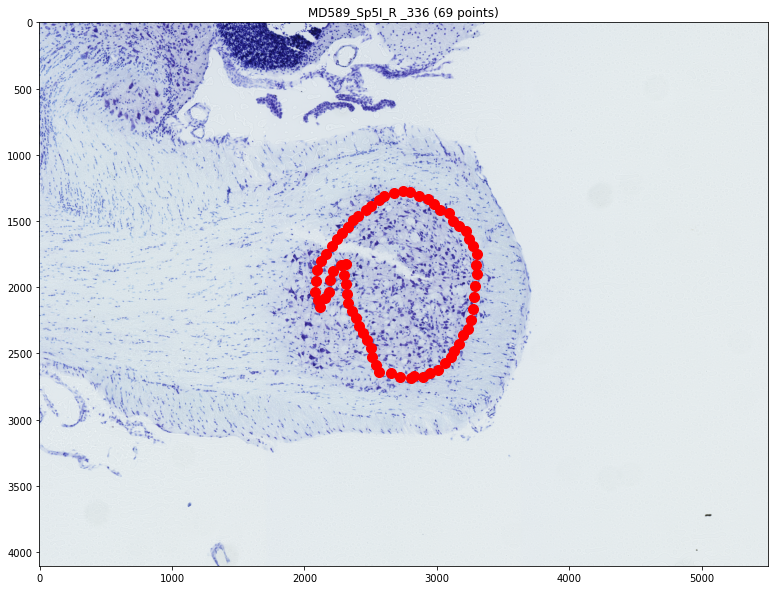

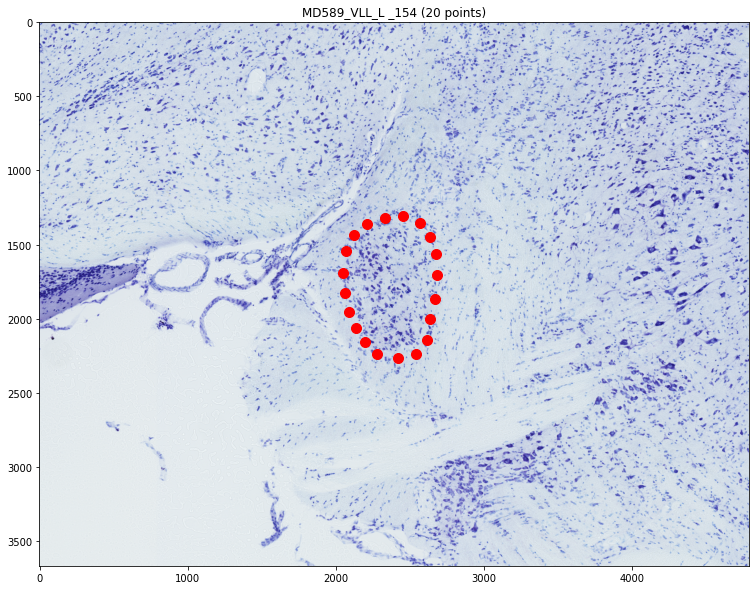

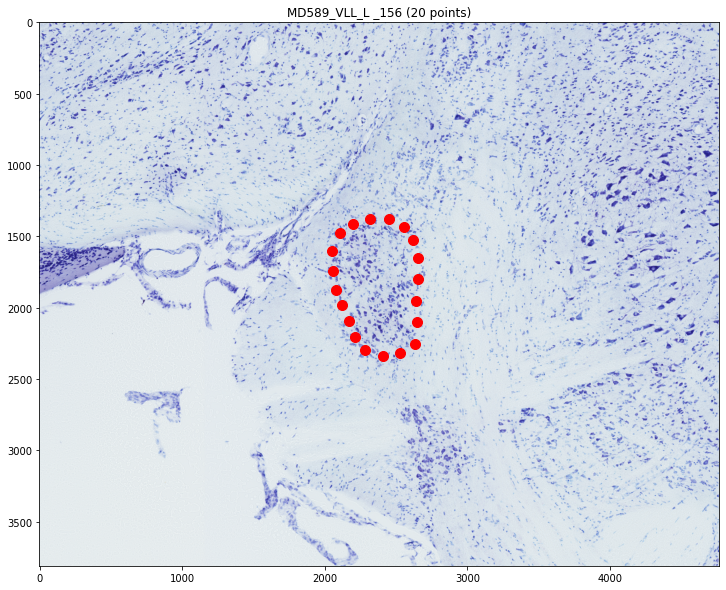

In [2]:
'''
COMPARE FOUNDATION BRAIN IMAGES' VERTICIES (ADJACENT SECTIONAL IMAGES)

CREATED: 14-MAR-2022
LAST EDIT: 14-MAR-2022
AUTHORS: DUANE
READ VERTICIES (POINTS) ON ADJACENT SECTIONAL IMAGES, [SCATTER] PLOT ON TOP OF IMAGE
'''

# e.g. full resolution images location 
# /net/birdstore/Active_Atlas_Data/data_root/pipeline_data/MD594/preps/CH1/full

import os
import re
from tifffile import imread #SUPPORTS TIFF FILES >2GB IN SIZE
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from pandas import ExcelWriter
from pandas import ExcelFile

out_path = "/net/birdstore/drinehart/img_compare/"
src_contours = os.path.join(out_path, "compare_adjacent.xlsx")

def load_contours():
    '''LOAD IN DUPLICATED (POTENTIALY) SETS OF CONTOURS (POINTS)'''
    in_contours = pd.read_excel(
        os.path.join(src_contours),
        engine='openpyxl',
    )
    return in_contours[['MOUSE','SECTION','STRUCTURE', 1]] 


def create_plot(mouse, section, structure, lstpairs1):
    #DEFINE PARTIAL IMAGE 'VIEW' (MARGINS) FOR IMG1
    cmin1=np.min(lstpairs1, axis=0)
    cmax1=np.max(lstpairs1, axis=0)
    margin1=np.array((cmin1*.9,cmax1*1.1)).astype(int)
    contour1 = np.array(lstpairs1)-cmin1*.9
    
    #LOAD BACKGROUND IMAGE ON PLOT
    img = imread(f"/net/birdstore/Active_Atlas_Data/data_root/pipeline_data/{mouse}/preps/CH1/full/{section}.tif")
    gimg=np.array(img)

    plt.figure(figsize=[30,10])
    #plt.subplot(1,2,1)
    
    cnt_verticies1 = np.count_nonzero(contour1, axis=0)[0]
    plt.title(f"{mouse}_{structure}_{section} ({cnt_verticies1} points)")
    plt.imshow(gimg[margin1[0,1]:margin1[1,1], margin1[0,0]:margin1[1,0]], cmap='gray')
    plt.scatter(contour1[:,0],contour1[:,1], color='r', s=100)

    out_filename = f"{mouse}_{structure}_{section}.jpg"
    plt.savefig(out_path+out_filename)


def parse_contours(contours1):
    #print(index, row['MOUSE'], row['SECTION'], row['STRUCTURE'], row[1], row[2]) - DEBUG: SRC LAYOUT
    print("PROGRESS", 'MOUSE', 'SECTION', 'STRUCTURE', sep=" : ")
    for index, row in contours1.iterrows():

        print("CURRENT- ", row['MOUSE'], row['SECTION'], row['STRUCTURE'], sep=" : ")

        #***PARSE X,Y VALUES (VERTICES)***
        #REMOVE BRACKETS FROM STRING
        lstcontour_points1 = re.sub(r"[\([{})\]]", '', row[1]).split("\n")

        lstpairs1 = []
        #LIST OF TUPLES - EACH TUPLE HAS X,Y POINTS
        for pairs in lstcontour_points1:
            lstpair = list(filter(str.strip,pairs.split(" "))) #REMOVE STRINGS ELEMENTS THAT ONLY CONTAIN WHITESPACE (NULL) FROM LIST
            pair = (float(lstpair[0]), float(lstpair[1]))
            lstpairs1.append(pair)
        
        create_plot(row['MOUSE'], row['SECTION'], row['STRUCTURE'], lstpairs1)

    return 'done'


contours = load_contours()
print("LOG:")
parse_contours(contours)